**Visualization library**

The purpose of this notebook is to have a readily available set of code as a cookbook for making certain kinds of plots. This will help me complete exploratory visualizations and create polished plots more efficiently.

The minimum viable product will be example code and figures for:
- quick EDA like pandas profiling and df.describe
- univariate data (histograms, violin plots, etc.)
- bivariate data (scatter plots)
- figure with multiple subplots
- using seaborn context to improve plot look

Nice to have:
- 3-D plots
- machine learning classification metrics
- statistical tests or metrics to accompany the plots
- custom visualizations like geopandas maps, baseball-related plots, genome sequencing plots

The SQL baseball data will be used as example input data.

# Setup

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [16]:
# Check versioning
import matplotlib
matplotlib.__version__

'3.1.3'

## Load example data

In [2]:
import sqlalchemy
import sqlalchemy_utils
from sqlalchemy import create_engine
from sqlalchemy_utils import database_exists, create_database
import psycopg2

In [3]:
# Define a database name
# Set your postgres username
dbname = "baseball"
username = "lacar"  # change this to your username

# Working with PostgreSQL in Python
# Connect to make queries using psycopg2
con = None
con = psycopg2.connect(database=dbname, user=username)

# Here, we're using postgres, but sqlalchemy can connect to other things too.
engine = create_engine("postgres://%s@localhost/%s" % (username, dbname))
print(engine.url)

postgres://lacar@localhost/baseball


In [20]:
sql_query = """
SELECT *
FROM batting_stats;
"""
df_query = pd.read_sql_query(sql_query, con)
df_query.head()

,index,Season,Name,Team,Age,G,AB,PA,H,1B,...,wSL/C _pi,wXX/C _pi,O-Swing_perc _pi,Z-Swing_perc _pi,Swing_perc _pi,O-Contact_perc _pi,Z-Contact_perc _pi,Contact_perc _pi,Zone_perc _pi,Pace _pi
0,63,2018.0,Mookie Betts,Red Sox,25.0,136.0,520.0,614.0,180.0,96.0,...,1.93,NaN,0.185,0.535,0.356,0.658,0.926,0.855,0.490,23.3
1,67,2018.0,Mike Trout,Angels,26.0,140.0,471.0,608.0,147.0,80.0,...,2.55,-5.67,0.198,0.555,0.376,0.660,0.903,0.839,0.498,23.3
2,86,2019.0,Mike Trout,Angels,27.0,134.0,470.0,600.0,137.0,63.0,...,2.44,-3.09,0.191,0.559,0.368,0.653,0.884,0.822,0.481,23.6
3,101,2019.0,Alex Bregman,Astros,25.0,156.0,554.0,690.0,164.0,84.0,...,1.28,NaN,0.169,0.552,0.349,0.724,0.920,0.870,0.471,26.0
4,96,2017.0,Aaron Judge,Yankees,25.0,155.0,542.0,678.0,154.0,75.0,...,-0.71,NaN,0.260,0.632,0.411,0.417,0.829,0.674,0.407,24.4


<IPython.core.display.Javascript object>

## Using custom colors

Colors can be set to match themes in slides or other color schemes. See here for finding codes for colors: [Google theme html colors](https://imagecolorpicker.com).

In [5]:
# Colors and formatting

B_beige = "#CDA577"
B_brown = "#643E34"
B_slate = "#3F5B66"
B_dkgray = "#5A7E8E"
B_ltgray = "#6D949B"
B_green = "#01CB8B"
B_lime = "#D3F04A"

B_colors = [B_beige, B_brown, B_slate, B_dkgray, B_ltgray, B_green, B_lime]
B_colors_cat = [B_beige, B_green, B_brown, B_ltgray, B_slate, B_lime, B_dkgray]

# Code formatting Jupyter black
%load_ext nb_black

<IPython.core.display.Javascript object>

# Quick, first-pass EDA

This is a good option when first encountering a dataset. A couple of options here take some time to run. They can be good candidates for running in the background. An .html file can be outputted which facilitates ease of data exploratin.

## `df.describe` 

In [18]:
df_query.describe()

,index,Season,Age,G,AB,PA,H,1B,2B,3B,...,wSL/C _pi,wXX/C _pi,O-Swing_perc _pi,Z-Swing_perc _pi,Swing_perc _pi,O-Contact_perc _pi,Z-Contact_perc _pi,Contact_perc _pi,Zone_perc _pi,Pace _pi
count,2937.000000,2937.000000,2937.000000,2937.000000,2937.000000,2937.000000,2937.000000,2937.000000,2937.000000,2937.000000,...,2528.000000,268.000000,2867.000000,2926.000000,2935.000000,2681.000000,2841.000000,2890.000000,2935.000000,2916.000000
mean,1468.000000,2018.011236,27.690160,61.457950,169.441607,189.632278,42.653388,26.962206,8.577460,0.826353,...,-2.229070,1.313507,0.323029,0.607997,0.466843,0.546846,0.815996,0.725372,0.513479,22.828292
std,847.983196,0.814261,3.715809,48.919821,195.260915,218.966990,53.356288,33.682617,11.285655,1.597793,...,5.707542,15.636745,0.163916,0.168099,0.121512,0.221280,0.168503,0.170015,0.118193,3.570228
min,0.000000,2017.000000,19.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,...,-38.190000,-34.130000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,734.000000,2017.000000,25.000000,21.000000,7.000000,8.000000,1.000000,1.000000,0.000000,0.000000,...,-4.220000,-4.270000,0.250000,0.557000,0.419000,0.467000,0.780000,0.670250,0.461000,21.200000
50%,1468.000000,2018.000000,27.000000,42.000000,62.000000,69.000000,13.000000,8.000000,2.000000,0.000000,...,-1.315000,1.270000,0.313000,0.631000,0.470000,0.567000,0.848000,0.750000,0.489000,23.400000
75%,2202.000000,2019.000000,30.000000,104.000000,313.000000,351.000000,79.000000,49.000000,15.000000,1.000000,...,0.310000,3.900000,0.376500,0.687000,0.515000,0.667000,0.901000,0.810000,0.536500,24.900000
max,2936.000000,2019.000000,45.000000,162.000000,681.000000,747.000000,213.000000,170.000000,58.000000,14.000000,...,55.650000,92.290000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,45.000000


<IPython.core.display.Javascript object>

## Pandas profiling

This is a separate package that extends the pandas profile version. [See here for documentation](https://github.com/pandas-profiling/pandas-profiling)

This can take some time to run. The original, full dataframe here had 2937 rows and 288 columns and it was not done after 10 minutes. I'll use the limited set of data (first 200 rows, first 25 columns) to show the full report. This still took ~3 minutes). I'll then use the "minimal" option with the full data.

In [22]:
from pandas_profiling import ProfileReport

<IPython.core.display.Javascript object>

In [ ]:
# check version
!pip freeze | grep pandas-profiling

In [24]:
df_query.shape

(2937, 288)

<IPython.core.display.Javascript object>

### Full report (runs slow)

In [28]:
profile = ProfileReport(df_query_limited, title="Pandas Profiling Report")

<IPython.core.display.Javascript object>

Note that alternative syntax is:
```
df_query_limited.profile_report()
```

In [29]:
profile

<IPython.core.display.Javascript object>

### Minimal mode

For large datasets, there is a "minimal mode" that disables expensive computations (such as correlations and dynamic binning). Use this syntax. The full dataframe has 2937 rows and 288 columns and took ~3 minutes to complete.

In [35]:
profile_minimal = ProfileReport(
    df_query, minimal=True, title="Minimal Pandas Profiling Report"
)

<IPython.core.display.Javascript object>

In [36]:
profile_minimal

<IPython.core.display.Javascript object>

### Outputting profiles as html reports

In [31]:
profile.to_file("BL_visualization_pandas_profiling_output.html")

<IPython.core.display.Javascript object>

In [37]:
profile_minimal.to_file("BL_visualization_pandas_profiling_minimal_output.html")

<IPython.core.display.Javascript object>

# Univariate data

## Histogram

### Quick and dirty with matplotlib

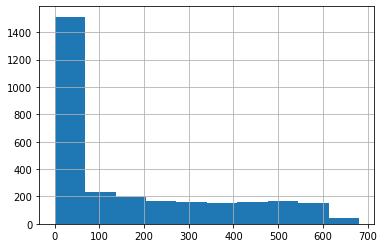

<IPython.core.display.Javascript object>

In [6]:
df_query["AB"].hist()

### Using custom colors and adding labels

Text(0, 0.5, 'histogram of at-bats')

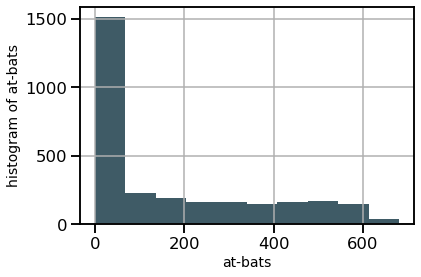

<IPython.core.display.Javascript object>

In [12]:
f, ax1 = plt.subplots()
df_query["AB"].hist(ax=ax1, color=B_slate)

ax1.set_xlabel("at-bats")
ax1.set_ylabel("no. of hitters")
ax1.set_ylabel("histogram of at-bats")

### Using seaborn context to set plot look

Setting context can be a fast way to set global settings across all the plots in the notebook.

In [13]:
sns.set_context(
    "talk", rc={"font.size": 16, "axes.titlesize": 16, "axes.labelsize": 14}
)

<IPython.core.display.Javascript object>

But make sure this is intended as it will overwrite the style of plots, even if you use the same code. Consider how this same code produces a plot that looks different from the first plot shown above ("quick and dirty" plot).

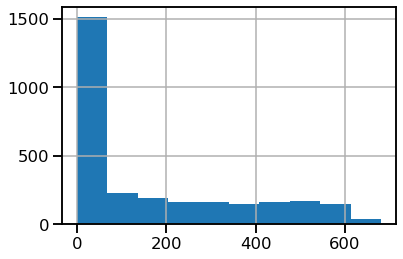

<IPython.core.display.Javascript object>

In [14]:
df_query["AB"].hist()

### Seaborn histogram

### Histogram by category

Let's filter the data by only looking at two teams (Padres and Dodgers) so that we can see how to plot a histogram using categories.

In [15]:
df_query_SDLA = df_query[df_query["Team"].isin(["Padres", "Dodgers"])].copy()

<IPython.core.display.Javascript object>

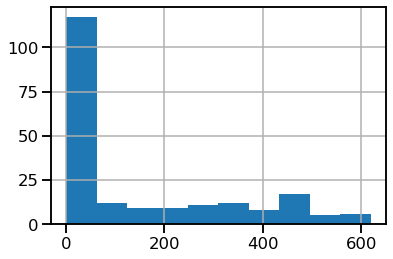

<IPython.core.display.Javascript object>

In [16]:
df_query_SDLA["AB"].hist()

### Histogram by category with facets

In [ ]:
g = sns.FacetGrid(tips, row="sex", col="time", margin_titles=True)
bins = np.linspace(0, 60, 13)
g.map(plt.hist, "total_bill", color="steelblue", bins=bins)

In [ ]:
# Basic
df_query['AB'].hist();

In [ ]:
# Using seaborn context